In [2]:
import cv2

# Read the image
image = cv2.imread(r"D:\DJI Datav2\raw file\DJI_202402201210_010_manual\DJI_20240220122621_0001_D.JPG", cv2.IMREAD_UNCHANGED)

# Check if the image exists
if image is None:
    print("Error: Unable to read the image.")
else:
    # Check if the image is 8-bit
    if image.dtype == 'uint8':
        print("The image is an 8-bit image.")
    else:
        print("The image is not an 8-bit image.")


The image is an 8-bit image.


In [3]:
import cv2
import numpy as np

def is_8bit_image(image):
  """Checks if the image is an 8-bit image.

  Args:
    image: The image to check.

  Returns:
    True if the image is an 8-bit image, False otherwise.
  """
  return np.issubdtype(image.dtype, np.uint8)

# Load the image
mask = cv2.imread(r"D:\DJI Datav2\raw file\DJI_202402201210_010_manual\DJI_20240220122621_0001_D.JPG", cv2.IMREAD_UNCHANGED)

# Example usage
if is_8bit_image(mask):
  print("The image is an 8-bit image.")
else:
  print("The image is not an 8-bit image.")


The image is an 8-bit image.


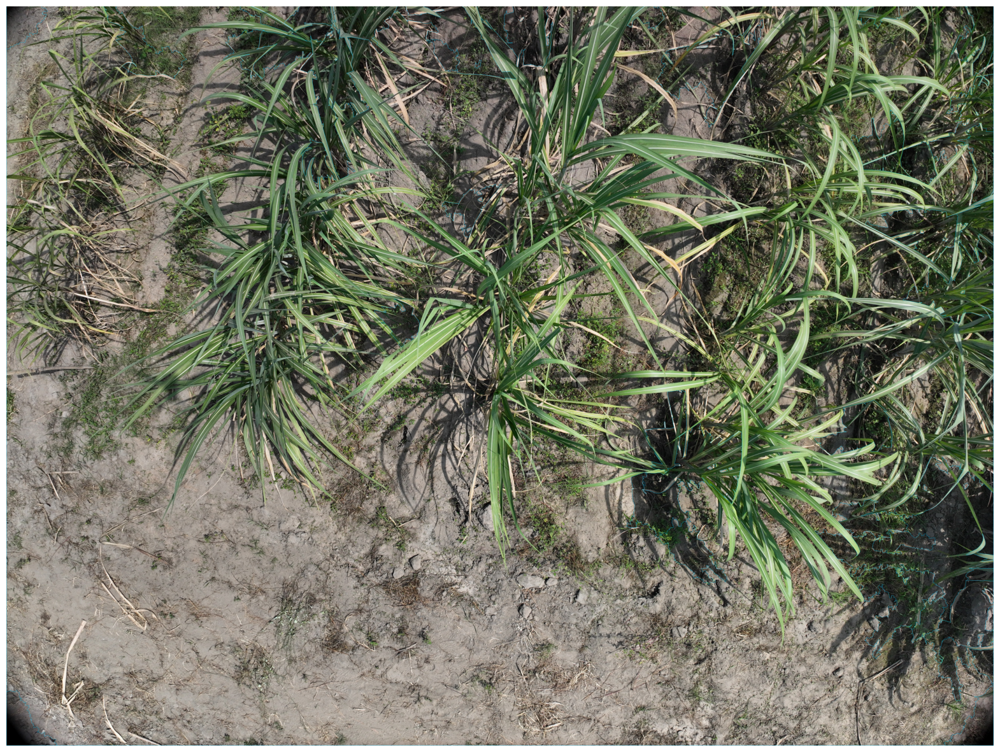

In [4]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def watershed_segmentation(image_path):
    # Read the image
    img = cv2.imread(image_path)
    
    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply thresholding (using a fixed threshold value)
    ret, thresh = cv2.threshold(gray, 150, 255, cv2.THRESH_BINARY_INV)
    
    # Noise removal
    kernel = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=5)
    
    # Sure background area
    sure_bg = cv2.dilate(opening, kernel, iterations=4)
    
    # Finding sure foreground area
    dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
    ret, sure_fg = cv2.threshold(dist_transform, 0.3 * dist_transform.max(), 255, 0)
    
    # Finding unknown region
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)
    
    # Marker labelling
    ret, markers = cv2.connectedComponents(sure_fg)
    
    # Add one to all labels so that sure background is not 0, but 1
    markers = markers + 1
    
    # Now, mark the region of unknown with zero
    markers[unknown == 255] = 0
    
    # Apply watershed algorithm
    markers = cv2.watershed(img, markers)
    img[markers == -1] = [255, 200, 0]  # Mark watershed boundaries
    
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for display with matplotlib

# Example usage
image_path = r"D:\DJI Datav2\raw file\DJI_202402201210_010_manual\DJI_20240220122621_0001_D.JPG"
segmented_image = watershed_segmentation(image_path)

plt.figure(figsize=(20, 20))

# Display the segmented image in the notebook cell
plt.imshow(segmented_image)
plt.axis('off')
plt.show()


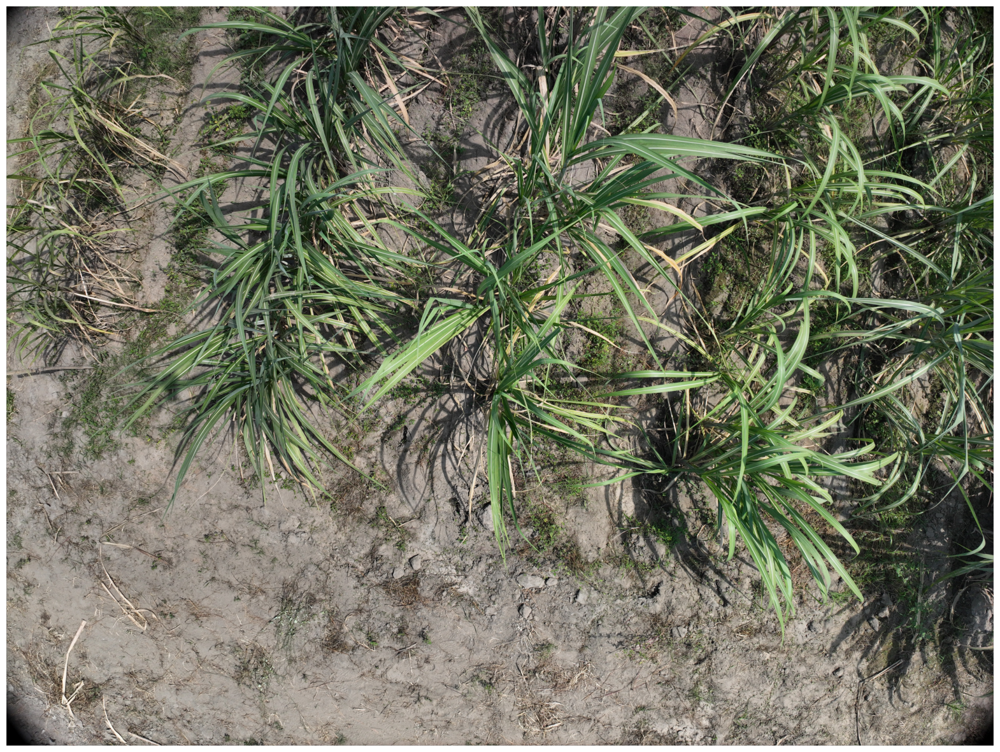

In [16]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def watershed_segmentation(image_path):
    # Read the image
    img = cv2.imread(image_path)
    
    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply thresholding (using a fixed threshold value)
    ret, thresh = cv2.threshold(gray, 150, 255, cv2.THRESH_BINARY_INV)
    
    # Noise removal
    kernel = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=5)
    
    # Sure background area
    sure_bg = cv2.dilate(opening, kernel, iterations=4)
    
    # Finding sure foreground area
    dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
    ret, sure_fg = cv2.threshold(dist_transform, 0.3 * dist_transform.max(), 255, 0)
    
    # Finding unknown region
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)
    
    # Marker labelling
    ret, markers = cv2.connectedComponents(sure_fg)
    
    # Add one to all labels so that sure background is not 0, but 1
    markers = markers + 1
    
    # Now, mark the region of unknown with zero
    markers[unknown == 255] = 0
    
    # Apply watershed algorithm
    markers = cv2.watershed(img, markers)
    
    # Remove the watershed boundaries by replacing them with the color of the segmented regions
    img[markers == -1] = img[markers != -1].mean(axis=0).mean(axis=0).astype(np.uint8)
    
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for display with matplotlib

# Example usage
image_path = r"I:\Dataset\DJI Data\raw file\DJI_202402201210_010_manual\DJI_20240220122621_0001_D.JPG"
segmented_image = watershed_segmentation(image_path)

plt.figure(figsize=(20, 20))

# Display the segmented image in the notebook cell
plt.imshow(segmented_image)
plt.axis('off')
plt.show()


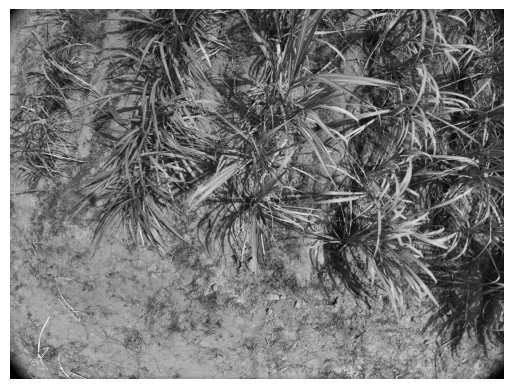

In [5]:
import cv2
import matplotlib.pyplot as plt

# Path to the image file
img_path = r"D:\DJI Datav2\raw file\DJI_202402201210_010_manual\DJI_20240220122621_0001_D.JPG"

# Read the image
img = cv2.imread(img_path)

# Check if the image is loaded successfully
if img is None:
    print("Error: Unable to read the image.")
else:
    # Convert image to grayscale
    im_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Display the grayscale image using Matplotlib
    plt.imshow(im_gray, cmap='gray')
    plt.axis('off')  # Turn off axis numbers and ticks
    plt.show()

    # Save the grayscale image to a variable
    grayscale_image_variable = im_gray


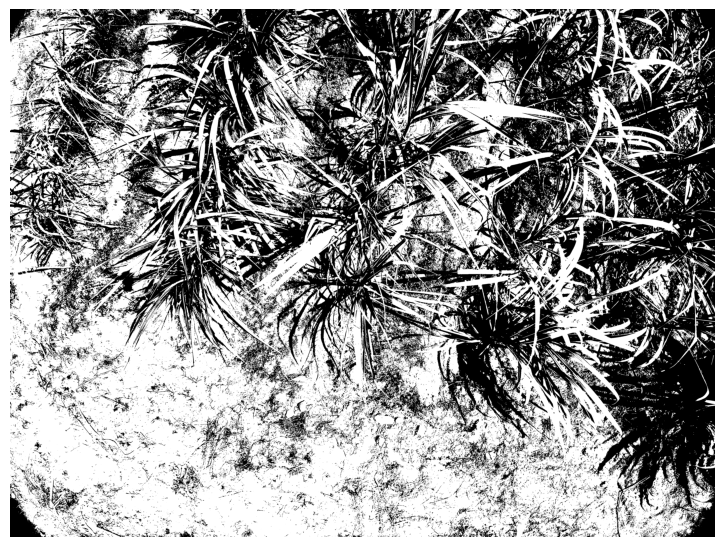

In [6]:
#Using Watershed
ret,th = cv2.threshold(im_gray,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(th,cmap='gray')
plt.axis("off")
plt.show()

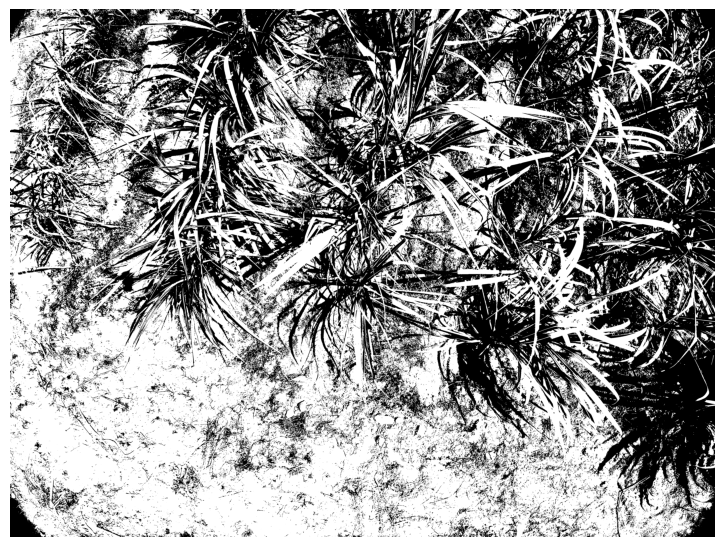

In [27]:
#Using Watershed
ret,th = cv2.threshold(im_gray,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(th,cmap='gray')
plt.axis("off")
plt.show()

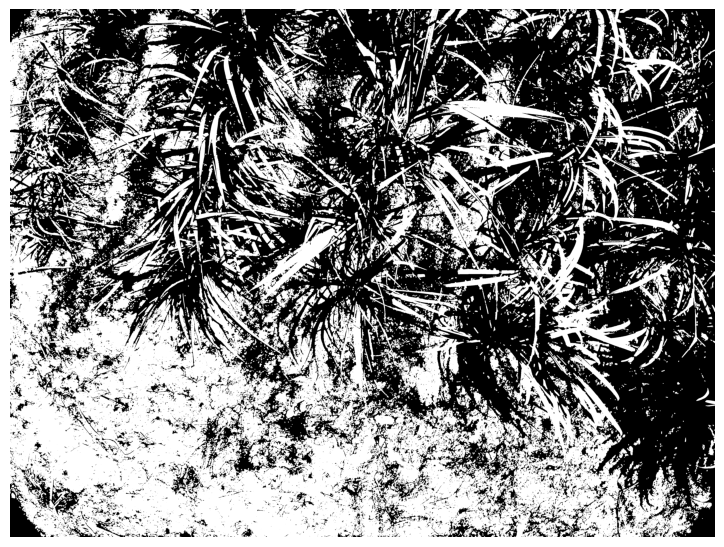

In [31]:
# noise removal
kernel = np.ones((3,3),np.uint8)
opening = cv2.morphologyEx(th,cv2.MORPH_OPEN,kernel, iterations = 2)
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(opening,cmap='gray')
plt.axis("off")
plt.show()

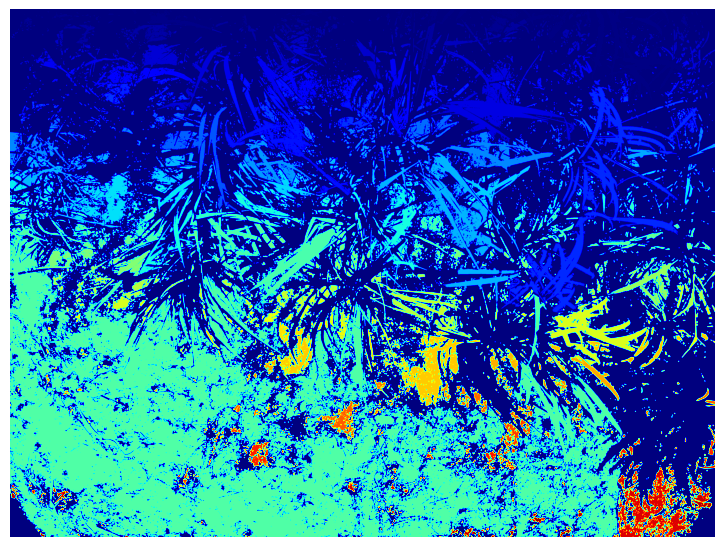

In [32]:
# sure background area
sure_bg = cv2.dilate(opening,kernel,iterations=3)
# Finding sure foreground area
dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
ret, sure_fg = cv2.threshold(dist_transform,0.005*dist_transform.max(),255,0)
# Finding unknown region
sure_fg = np.uint8(sure_fg)
unknown = cv2.subtract(sure_bg,sure_fg)
# Marker labelling
ret, markers = cv2.connectedComponents(sure_fg)
# Add one to all labels so that sure background is not 0, but 1
markers = markers+1
# Now, mark the region of unknown with zero
markers[unknown==255] = 0
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(markers,cmap='jet')
plt.axis("off")
plt.show()

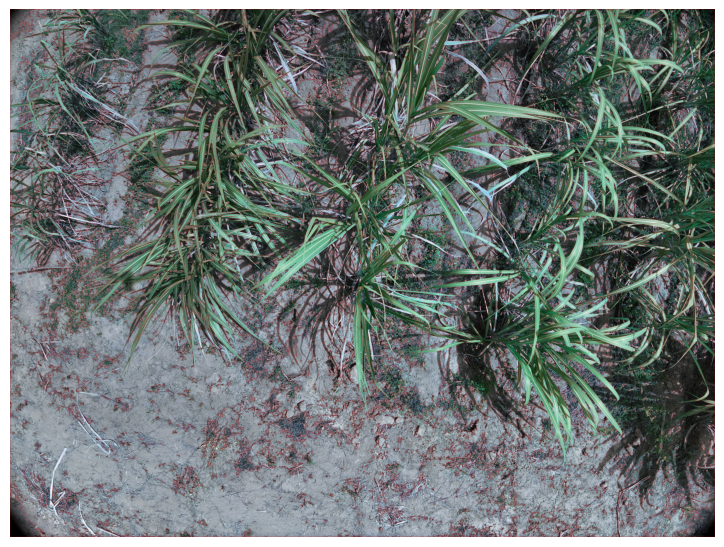

In [35]:
markers = cv2.watershed(img,markers)
img[markers == -1] = [255,0,0]
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(img,cmap='gray')
plt.axis("off")
plt.show()

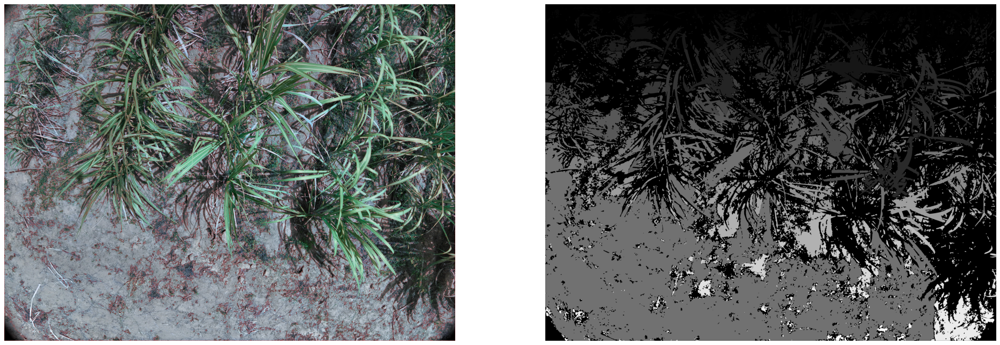

In [36]:
fig=plt.figure(figsize=(30, 40), dpi= 80, facecolor='w', edgecolor='k')
plt.axis("off")
plt.subplot(121)
plt.imshow(img)
plt.axis("off")
plt.subplot(122)
plt.imshow(markers,cmap='gray')
plt.axis("off")
plt.show()

In [37]:
mask = np.where(markers > sure_fg, 1, 0)
# Make sure the larger portion of the mask is considered background
if np.sum(mask==0) < np.sum(mask==1):
    mask = np.where(mask, 0, 1)

In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Path to the image
image_path = r"D:\Dataset\sugarcanev3.v1i.voc\PNGImages\DJI_20240220122623_0002_D_quarter_1_1_png.rf.417fb664441fa22908ba3f4803fadddb.jpg"

# Read the image
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
orig_img = img.copy()



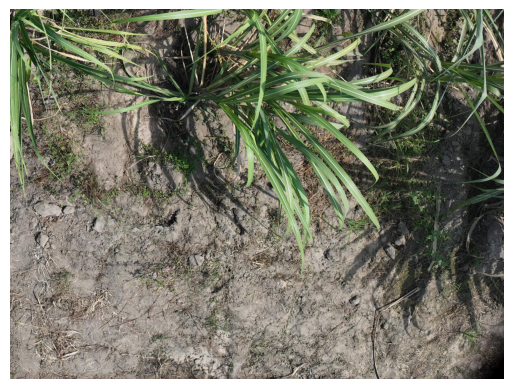

In [9]:
# Display original image
plt.imshow(orig_img)
plt.axis('off')
plt.show()


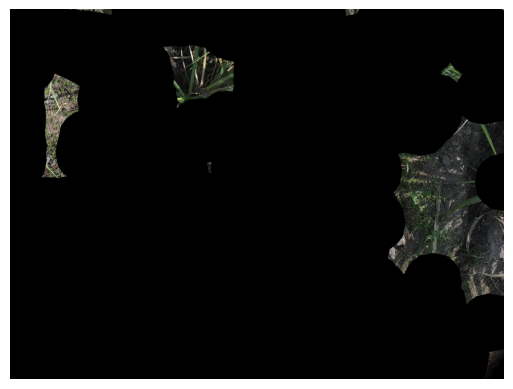

In [12]:
# Convert to grayscale
gray = cv2.cvtColor(img.copy(), cv2.COLOR_BGR2GRAY)

# Threshold Processing
ret, bin_img = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Noise removal
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
bin_img = cv2.morphologyEx(bin_img, cv2.MORPH_CLOSE, kernel, iterations=7)
bin_img = cv2.dilate(bin_img, kernel, iterations=5)

# Distance transform
dist = cv2.distanceTransform(bin_img, cv2.DIST_L2, 5)

# Foreground area
ret, sure_fg = cv2.threshold(dist, 0.4 * dist.max(), 255, cv2.THRESH_BINARY)
sure_fg = sure_fg.astype(np.uint8)

# Apply the mask to the original image to extract the region
region = cv2.bitwise_and(orig_img, orig_img, mask=sure_fg)

# Display the result
plt.imshow(region)
plt.axis('off')
plt.show()


c:\Users\jeric\.conda\envs\convert\lib\site-packages\rasterio\__init__.py:331: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
C:\Users\jeric\AppData\Local\Temp\ipykernel_27668\881775715.py:10: RuntimeWarning: divide by zero encountered in divide
  ndvi = (nir - red) / (nir + red)


AttributeError: 'numpy.ndarray' object has no attribute 'read'

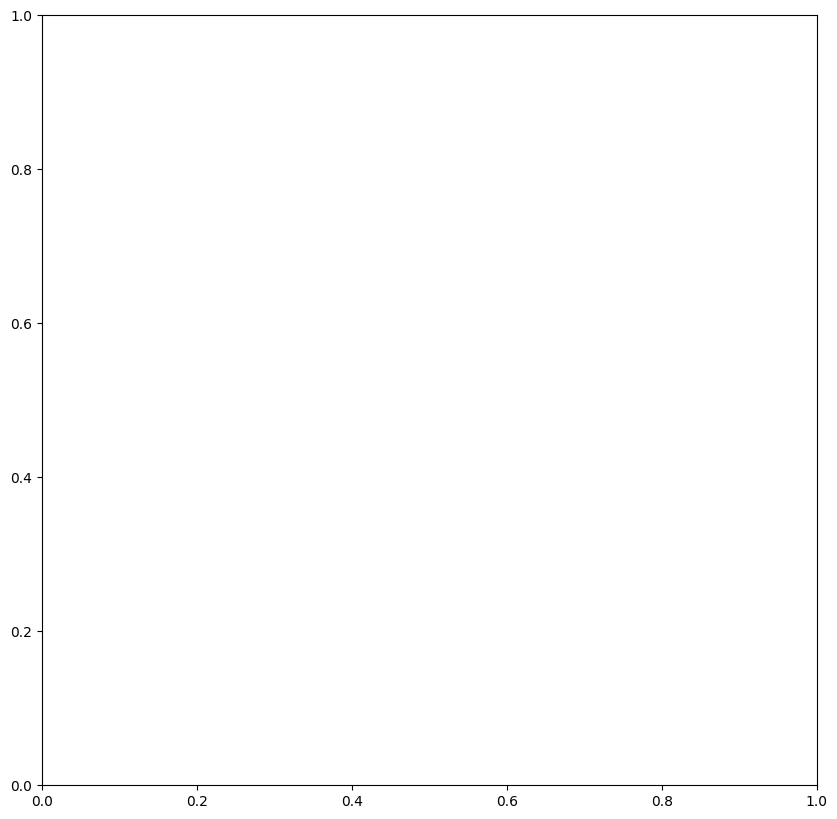

In [15]:
import numpy as np
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

def calculate_ndvi(nir, red):
    """
    Calculate NDVI (Normalized Difference Vegetation Index)
    """
    ndvi = (nir - red) / (nir + red)
    return ndvi

def create_ndvi_overlay(nir_image, red_image, save_path=None):
    """
    Create an overlay of NDVI from NIR and Red images
    """
    # Open NIR and Red images
    with rasterio.open(nir_image) as nir_src:
        nir = nir_src.read(1)
    with rasterio.open(red_image) as red_src:
        red = red_src.read(1)

    # Calculate NDVI
    ndvi = calculate_ndvi(nir, red)

    # Plot NDVI
    fig, ax = plt.subplots(figsize=(10, 10))
    show((red, 1), cmap='Reds', ax=ax, alpha=0.5)  # Red channel as base
    show((ndvi, 1), cmap='viridis', ax=ax, alpha=0.5)  # NDVI overlay
    ax.set_title('NDVI Overlay')
    ax.set_xticks([])
    ax.set_yticks([])

    # Add colorbar for NDVI scale
    cbar = plt.colorbar(ax.collections[1], ax=ax, orientation='vertical', pad=0.02)
    cbar.set_label('NDVI')

    if save_path:
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0)
    else:
        plt.show()

# Example usage
create_ndvi_overlay(r'D:\Dataset\DJI Data\raw file\DJI_202402201210_010_manual\DJI_20240220122621_0001_MS_NIR.TIF', r'D:\Dataset\DJI Data\raw file\DJI_202402201210_010_manual\DJI_20240220122621_0001_MS_R.TIF', 'ndvi_overlay.png')
